# Notebook to apply VAME to some of the Konstanz dataset

Changes in notebook and config:

- remaining NaN-values are replaced with negative numbers (only missing-data periods of max. 10 consecutive frames in pose data were interpolated previously)
- in config: 
    - increased time_window to 50
    - decreased prediction_steps to 10
    - decreased length_of_motif_video to 500

In [1]:
import vame
from vame.util.sample_data import download_sample_data
from pathlib import Path

2026-02-25 03:56:30.806 INFO  --- [MainThread] numexpr.utils   : 164 : NumExpr defaulting to 16 threads.
2026-02-25 03:56:34.914 INFO  --- [MainThread] vame.model.rnn_vae : 31 : GPU detected
2026-02-25 03:56:34.938 INFO  --- [MainThread] vame.model.rnn_vae : 32 : GPU used: NVIDIA GeForce RTX 4070


In [2]:
FPS=50

VIDEO_DATA_PATH = "/mnt/windows-ssd/trophallaxis_detection_code/data/individual_videos_merged_konstanz/"
VIDEOS = [
    VIDEO_DATA_PATH + "hex_03_bee0_300--1377.mp4",
    VIDEO_DATA_PATH + "hex_03_bee1_300--1377.mp4",
    VIDEO_DATA_PATH + "hex_03_bee2_300--1377.mp4",
    VIDEO_DATA_PATH + "hex_03_bee3_300--1377.mp4",
    VIDEO_DATA_PATH + "hex_05_bee0_300--1505.mp4",
    VIDEO_DATA_PATH + "hex_05_bee1_300--1505.mp4",
    VIDEO_DATA_PATH + "hex_05_bee2_300--1505.mp4",
    VIDEO_DATA_PATH + "hex_05_bee3_300--1505.mp4",
]
POSE_DATA_PATH = "/mnt/windows-ssd/trophallaxis_detection_code/data/marker_data_konstanz/"
POSES_ESTIMATIONS = [
    POSE_DATA_PATH + "hex_03_bee0_300--1377.csv",
    POSE_DATA_PATH + "hex_03_bee1_300--1377.csv",
    POSE_DATA_PATH + "hex_03_bee2_300--1377.csv",
    POSE_DATA_PATH + "hex_03_bee3_300--1377.csv",
    POSE_DATA_PATH + "hex_05_bee0_300--1505.csv",
    POSE_DATA_PATH + "hex_05_bee1_300--1505.csv",
    POSE_DATA_PATH + "hex_05_bee2_300--1505.csv",
    POSE_DATA_PATH + "hex_05_bee3_300--1505.csv",
]

## Initialize project

This step creates the project with a config file if they don't exist yet - update the config parameters before continuing if you want to change something from the defauts selected by VAME

In [3]:
import os
from vame.util.auxiliary import read_config

project_name="vame_konstanz_data_with_accel"
project_path = str(Path(".").resolve() / project_name)
if os.path.exists(project_path):
    config_file = os.path.join(str(project_path), "config.yaml")
    config_data = read_config(config_file)
else:
    config_file, config_data = vame.init_new_project(
        project_name=project_name,
        videos=VIDEOS,
        poses_estimations=POSES_ESTIMATIONS,
        source_software="DeepLabCut",
        fps=FPS,
        video_type=".mp4"
    )

2026-02-25 03:56:39.743 INFO  --- [MainThread] vame.initialize_project.new : 109 : Created "/mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/data"
2026-02-25 03:56:39.744 INFO  --- [MainThread] vame.initialize_project.new : 109 : Created "/mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/data/raw"
2026-02-25 03:56:39.745 INFO  --- [MainThread] vame.initialize_project.new : 109 : Created "/mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/data/processed"
2026-02-25 03:56:39.746 INFO  --- [MainThread] vame.initialize_project.new : 109 : Created "/mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/results"
2026-02-25 03:56:39.746 INFO  --- [MainThread] vame.initialize_project.new : 109 : Created "/mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/model"
2026-02-25 03:56:39.746 INFO  --- [MainThread] vame.initialize_proj

In [4]:
ds_path = Path(config_data["project_path"]) / "data" / "raw" / f"{config_data['session_names'][0]}.nc"
vame.io.load_poses.load_vame_dataset(ds_path)

<xarray.Dataset> Size: 7MB
Dimensions:      (time: 53851, space: 2, keypoints: 5, individuals: 1)
Coordinates:
  * time         (time) float64 431kB 0.0 0.02 0.04 ... 1.077e+03 1.077e+03
  * space        (space) <U1 8B 'x' 'y'
  * keypoints    (keypoints) <U13 260B 'left_antenna' ... 'abdomen_tip'
  * individuals  (individuals) <U12 48B 'individual_0'
Data variables:
    position     (time, space, keypoints, individuals) float64 4MB nan ... 95.34
    confidence   (time, keypoints, individuals) float64 2MB 1.0 1.0 ... 1.0 1.0
Attributes:
    source_software:  DeepLabCut
    ds_type:          poses
    fps:              50.0
    time_unit:        seconds
    source_file:      /mnt/windows-ssd/trophallaxis_detection_code/data/marke...
    video_path:       /mnt/windows-ssd/trophallaxis_detection_code/data/indiv...

## Preprocessing

In supplementry material of VAME it was mentioned that the authors only interpolated short missing data periods and set the remaining values to an arbitrary neg. value - I do the same here

In [5]:
from pathlib import Path
import numpy as np
import logging
from scipy.stats import iqr

from vame.logging.logger import VameLogger
from vame.io.load_poses import read_pose_estimation_file


logger_config = VameLogger(
    __name__, 
    log_level=logging.DEBUG
)
logger = logger_config.logger


def set_nan_to_neg(
    config: dict,
    read_from_variable: str = "position",
    save_to_variable: str = "position",
    save_logs: bool = True,
) -> None:
    """Set all NaN values in the pose data to an arbitrary negative value

    Args:
        config (dict): Configuration dictionary.
        read_from_variable (str, optional): Variable to read from the dataset.. Defaults to "position".
        save_to_variable (str, optional): Variable to save the cleaned data to.. Defaults to "position".
        save_logs (bool, optional): Whether to save logs.. Defaults to True.
    """
    
    if save_logs:
        log_path = Path(config["project_path"]) / "logs" / "preprocessing.log"
        logger_config.add_file_handler(str(log_path))

    project_path = config["project_path"]
    sessions = config["session_names"]
    pose_confidence = config["pose_confidence"]
    logger.info(f"Cleaning low confidence data points. Confidence threshold: {pose_confidence}")

    for i, session in enumerate(sessions):
        logger.info(f"Session: {session}")
        # Read session data
        file_path = str(Path(project_path) / "data" / "processed" / f"{session}_processed.nc")
        _, _, ds = read_pose_estimation_file(file_path=file_path)

        position = ds[read_from_variable].values  # shape: (time, space, keypoints, individuals)
        position_nans_replaced = np.copy(position)

        for individual in range(position.shape[3]):
            for keypoint in range(position.shape[2]):
                for space in range(position.shape[1]):
                    series = np.copy(position[:, space, keypoint, individual])
                    series[np.isnan(series)] = -10

                    position_nans_replaced[:, space, keypoint, individual] = series

        # Update the dataset with the cleaned position values
        ds[save_to_variable] = (ds[read_from_variable].dims, position_nans_replaced)
        ds.attrs.update({"processed_nans": "True"})

        # Save the cleaned dataset to file
        cleaned_file_path = str(Path(project_path) / "data" / "processed" / f"{session}_processed.nc")
        ds.to_netcdf(
            path=cleaned_file_path,
            engine="netcdf4",
        )

set_nan_to_neg(config=config_data)

vame.preprocessing(
    config=config_data,
    centered_reference_keypoint="head",
    orientation_reference_keypoint="abdomen_tip",
)


2026-02-25 03:57:32.704 INFO  --- [MainThread] __main__        : 39 : Cleaning low confidence data points. Confidence threshold: 0.99
2026-02-25 03:57:32.704 INFO  --- [MainThread] __main__        : 42 : Session: hex_03_bee0_300--1377
2026-02-25 03:57:32.773 INFO  --- [MainThread] __main__        : 42 : Session: hex_03_bee1_300--1377
2026-02-25 03:57:32.835 INFO  --- [MainThread] __main__        : 42 : Session: hex_03_bee2_300--1377
2026-02-25 03:57:32.891 INFO  --- [MainThread] __main__        : 42 : Session: hex_03_bee3_300--1377
2026-02-25 03:57:32.946 INFO  --- [MainThread] __main__        : 42 : Session: hex_05_bee0_300--1505
2026-02-25 03:57:33.5 INFO  --- [MainThread] __main__        : 42 : Session: hex_05_bee1_300--1505
2026-02-25 03:57:33.66 INFO  --- [MainThread] __main__        : 42 : Session: hex_05_bee2_300--1505
2026-02-25 03:57:33.127 INFO  --- [MainThread] __main__        : 42 : Session: hex_05_bee3_300--1505
2026-02-25 03:57:33.199 INFO  --- [MainThread] vame.preproces

'position_processed'

## Add acceleration as a (derived) feature to the data

In [6]:
import numpy as np
from scipy.stats import iqr
from scipy.signal import savgol_filter
import pandas as pd
import matplotlib.pyplot as plt
from vame.util.derived_features import Feature
from vame.io.load_poses import read_pose_estimation_file



csv_files_deriv = [
    "hex_03_deriv_features_300--1377.csv", 
    "hex_05_deriv_features_300--1505.csv"
]
dfs = []

# read csv with derived variable(s)
for file in csv_files_deriv:
    df_deriv = pd.read_csv(
        "/mnt/windows-ssd/trophallaxis_detection_code/data/marker_data_konstanz/" + file, 
        delimiter= ',',
        dtype={'bee_id': np.int32, 'accel': np.float64}
    )
    dfs.append((df_deriv, file.split(".")[0]))


feature_data: dict[str, list[Feature]] = {}

def preprocess_deriv(
    dfs: pd.DataFrame, 
    plot: bool = False
):
    """
    Args:
        dfs (pd.Dataframe): Dataframes with derived variable(s)
        plot (bool): Whether to plot the data series for each feature after each processing step
    """

    for df_deriv, filename in dfs:
        n_bees: int = df_deriv["bee_id"].nunique()
        data_rows = len(df_deriv)
        n_frames = int(data_rows / n_bees)

        accel = df_deriv["accel"].to_numpy().reshape(n_bees, n_frames)

        if plot:
            plt.plot(range(n_frames), accel[0])
            plt.show()

        ######################################################################
        # Clean the outliers from the dataset. Processes position data by:
        #     - setting outlier points to NaN
        #     - interpolating NaN points
        ######################################################################

        cleaned_accel = np.copy(accel)

        for bee_id in range(accel.shape[0]):
            series = np.copy(accel[bee_id, :])

            # Calculate Z-score
            z_series = (series - np.nanmean(series)) / np.nanstd(series)

            # Set outlier positions to NaN, based on IQR cutoff
            if config_data["robust"]:
                iqr_factor = 3
                iqr_val = iqr(z_series)
                outlier_mask = np.abs(z_series) > iqr_factor * iqr_val
                series[outlier_mask] = np.nan

                # Interpolate NaN values of the original series
                if not outlier_mask.all():
                    series[outlier_mask] = np.interp(
                        np.flatnonzero(outlier_mask),
                        np.flatnonzero(~outlier_mask),
                        series[~outlier_mask],
                    )
            
            cleaned_accel[bee_id, :] = series


        logger.debug(f"cleaned_accel: {cleaned_accel}")
        logger.debug((cleaned_accel > 500).sum())

        if plot:
            plt.plot(range(n_frames), cleaned_accel[0])
            plt.show()


        # --- Apply Savitzky-Golay filter to the data. ---

        filtered_accel = np.copy(cleaned_accel)
        for bee_id in range(accel.shape[0]):
            series = np.copy(cleaned_accel[bee_id, :])

            savgol_length = config_data["savgol_length"]
            savgol_order = config_data["savgol_order"]
            filtered_accel[bee_id, :] = savgol_filter(
                x=series,
                window_length=savgol_length,
                polyorder=savgol_order
            )
        logger.debug(f"filtered_accel: {filtered_accel}")

        if plot:
            plt.plot(range(n_frames), filtered_accel[0])
            plt.show()


        # --- Scale derived variables ---

        keypoint_data = []
        sessions = config_data["session_names"]
        for session in sessions:
            # Read session data
            file_path = str(Path(project_path) / "data" / "processed" / f"{session}_processed.nc")
            _, _, ds = read_pose_estimation_file(file_path=file_path)

            keypoints = ds.keypoints.values
            data = ds["position_processed"]
            centered_reference_keypoint = ds.attrs["centered_reference_keypoint"]
            orientation_reference_keypoint = ds.attrs["orientation_reference_keypoint"]

            # Select the first individual
            individuals = data.coords["individuals"].values
            data = data.sel(individuals=individuals[0])

            # Extract spaces and keypoints from the dataset
            spaces = data.coords["space"].values
            original_keypoints = data.coords["keypoints"].values
            if keypoints is None:
                keypoints = list(original_keypoints)
            else:
                data = data.sel(keypoints=keypoints)

            # Create an array with filtered data (n_samples, n_features - 3)
            feature_mapping = []
            excluded_features = []

            for kp in keypoints:
                if kp == centered_reference_keypoint:
                    # Track excluded features
                    for sp in spaces:
                        excluded_features.append(f"{kp}_{sp}")
                    continue
                for sp in spaces:
                    if sp == "x" and kp == orientation_reference_keypoint:
                        # Track excluded feature
                        excluded_features.append(f"{kp}_{sp}")
                        continue
                    column_data = data.sel(keypoints=kp, space=sp).values.reshape(-1)
                    keypoint_data.append(column_data)

        # flatten the array                
        keypoint_data = np.concatenate(keypoint_data)
        logger.debug(f"Length of keypoints array: {len(keypoint_data)}")
        logger.debug(f"Standard deviation of keypoints: {np.std(keypoint_data)}")

        scaled_accel = filtered_accel / np.std(filtered_accel) * np.std(keypoint_data)
        logger.debug(f"scaled_accel: {scaled_accel}")

        if plot:
            plt.plot(range(n_frames), scaled_accel[0])
            plt.show()


        for bee_id, series in enumerate(scaled_accel):
            file_split = filename.split("deriv_features")
            video_name = file_split[0] + "bee" + str(bee_id) + file_split[1]
            feature_data[video_name] = [Feature("acceleration", series)]


preprocess_deriv(dfs)

#######################################################################################
#   5 keypoints currently * 2 spaces (x and y) = 10 features 
#   --> 10 features - 3 features because of egocentric alignment:
#       -2 for centered_reference_keypoint and -1 for orientation_reference_keypoint
#######################################################################################
N_FEATURES_DEFAULT = 10-3

# I added this function to VAME
vame.add_derived_features(
    config=config_data, 
    feature_data=feature_data,
    n_features_without_deriv = N_FEATURES_DEFAULT
)

2026-02-25 03:58:13.137 DEBUG --- [MainThread] __main__        : 82 : cleaned_accel: [[ 38.125713  70.30034   17.050337 ... 167.87096   76.627365 474.85098 ]
 [ 68.20135   85.251686 107.8358   ... 222.296     54.139645 176.32994 ]
 [ 68.201645 103.83255   51.156113 ...  24.327362  92.2328   103.56434 ]
 [175.54396   48.225636   0.       ... 221.48532  137.5883   281.64874 ]]
2026-02-25 03:58:13.138 DEBUG --- [MainThread] __main__        : 83 : 5673
2026-02-25 03:58:13.140 DEBUG --- [MainThread] __main__        : 103 : filtered_accel: [[ 46.97419409  45.17120686  39.34684991 ... 149.0255618  216.380894
  408.1151152 ]
 [ 69.42857983  86.58643669  96.46816897 ... 185.46335343 160.89174271
  129.09266557]
 [ 83.69709703  69.74490709  60.44632957 ...  39.54533497  67.92781269
  113.18050483]
 [160.47152089  70.58160766  23.36671971 ... 152.93845543 183.15578171
  270.28947657]]
2026-02-25 03:58:13.294 DEBUG --- [MainThread] __main__        : 156 : Length of keypoints array: 3194632
2026-02

In [7]:
vame.create_trainset(
    config=config_data,
    read_derivatives_from_variables=["acceleration"],
)

2026-02-25 03:58:49.859 INFO  --- [MainThread] vame.model.create_training : 323 : Creating training dataset...
2026-02-25 03:58:50.2 INFO  --- [MainThread] vame.model.create_training : 189 : Session hex_03_bee0_300--1377: test chunk 15795:21180 (length 5385)
2026-02-25 03:58:50.3 INFO  --- [MainThread] vame.model.create_training : 189 : Session hex_03_bee1_300--1377: test chunk 860:6245 (length 5385)
2026-02-25 03:58:50.3 INFO  --- [MainThread] vame.model.create_training : 189 : Session hex_03_bee2_300--1377: test chunk 38158:43543 (length 5385)
2026-02-25 03:58:50.4 INFO  --- [MainThread] vame.model.create_training : 189 : Session hex_03_bee3_300--1377: test chunk 44732:50117 (length 5385)
2026-02-25 03:58:50.4 INFO  --- [MainThread] vame.model.create_training : 189 : Session hex_05_bee0_300--1505: test chunk 11284:17308 (length 6024)
2026-02-25 03:58:50.5 INFO  --- [MainThread] vame.model.create_training : 189 : Session hex_05_bee1_300--1505: test chunk 6265:12289 (length 6024)
2026-

In [8]:
vame.train_model(config=config_data)

2026-02-25 03:58:50.174 INFO  --- [MainThread] vame.model.rnn_vae : 572 : Train Variational Autoencoder - model name: VAME 

2026-02-25 03:58:50.176 INFO  --- [MainThread] vame.model.rnn_vae : 588 : TensorBoard logging enabled. Log directory: /mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/logs/tensorboard/VAME
2026-02-25 03:58:50.177 INFO  --- [MainThread] vame.model.rnn_vae : 589 : To view logs, run: tensorboard --logdir=/mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/logs/tensorboard --port=6006
2026-02-25 03:58:50.177 INFO  --- [MainThread] vame.model.rnn_vae : 594 : Using CUDA
2026-02-25 03:58:50.178 INFO  --- [MainThread] vame.model.rnn_vae : 595 : GPU active: True
2026-02-25 03:58:50.178 INFO  --- [MainThread] vame.model.rnn_vae : 596 : GPU used: NVIDIA GeForce RTX 4070
2026-02-25 03:58:50.178 INFO  --- [MainThread] vame.model.rnn_vae : 641 : Latent Dimensions: 30, Time window: 30, Batch Size: 256, Beta: 1

In [9]:
vame.evaluate_model(config=config_data)

2026-02-25 06:07:29.221 INFO  --- [MainThread] vame.model.evaluate : 314 : Using CUDA
2026-02-25 06:07:29.222 INFO  --- [MainThread] vame.model.evaluate : 315 : GPU active: True
2026-02-25 06:07:29.222 INFO  --- [MainThread] vame.model.evaluate : 316 : GPU used: NVIDIA GeForce RTX 4070
2026-02-25 06:07:29.222 INFO  --- [MainThread] vame.model.evaluate : 321 : Evaluation of model: VAME
2026-02-25 06:07:29.244 INFO  --- [MainThread] vame.model.evaluate : 64 : Initialize test data. Datapoints 45636
2026-02-25 06:07:29.621 INFO  --- [MainThread] vame.model.evaluate : 343 : Evaluation finished successfully! You can find the results in: '/mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/model/evaluate/'
2026-02-25 06:07:29.621 INFO  --- [MainThread] vame.model.evaluate : 344 : Next steps:
            - vame.segment_session() to identify behavioral motifs.
            - re-run the model for further fine tuning. Check again with vame.evaluate_model()


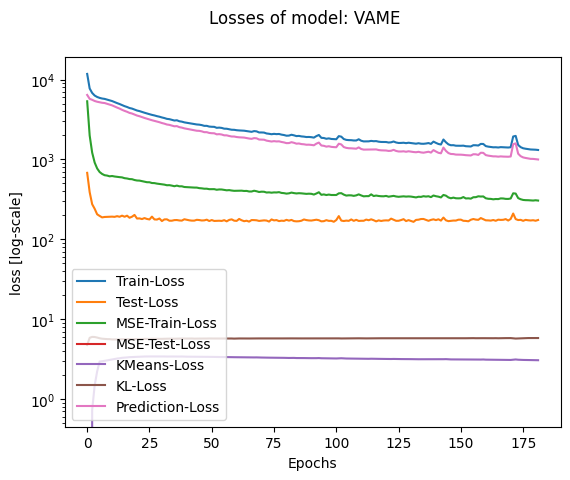

In [10]:
from vame.visualization import plot_loss

plot_loss(config=config_data)

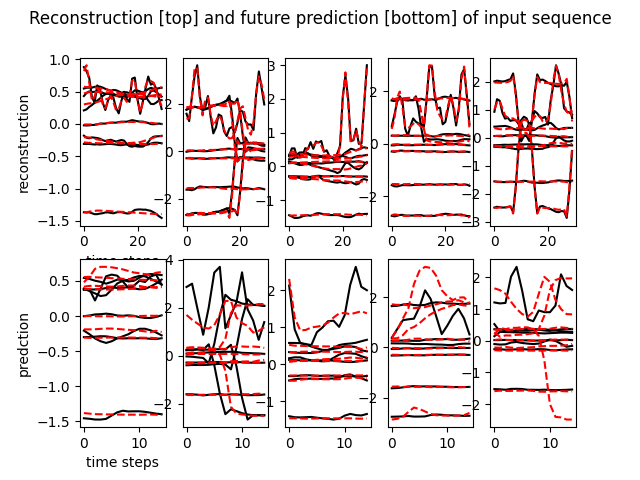

In [11]:
from IPython.display import Image, display

eval_plot_path = Path(config_data["project_path"]) / "model" / "evaluate" / "future_reconstruction.png"
display(Image(filename=eval_plot_path))

In [12]:
vame.segment_session(
    config=config_data,
    read_derivatives_from_variables=["acceleration"],
    overwrite_segmentation=False,
    overwrite_embeddings=False,
)

2026-02-25 06:07:29.853 INFO  --- [MainThread] vame.analysis.pose_segmentation : 175 : ---------------------------------------------------------------------
2026-02-25 06:07:29.853 INFO  --- [MainThread] vame.analysis.pose_segmentation : 176 : Embedding latent vectors for VAME model (OPTIMIZED)
2026-02-25 06:07:29.854 INFO  --- [MainThread] vame.util.model_util : 56 : Loaded training metadata with 5 keypoints
2026-02-25 06:07:29.854 INFO  --- [MainThread] vame.util.model_util : 57 : Keypoints used during training: ['left_antenna', 'right_antenna', 'head', 'thorax', 'abdomen_tip']
2026-02-25 06:07:29.855 INFO  --- [MainThread] vame.analysis.pose_segmentation : 200 : Embedding of latent vector for file hex_03_bee0_300--1377
2026-02-25 06:07:29.855 INFO  --- [MainThread] vame.util.auxiliary : 35 : Using CUDA
2026-02-25 06:07:29.856 INFO  --- [MainThread] vame.util.auxiliary : 36 : GPU active: True
2026-02-25 06:07:29.856 INFO  --- [MainThread] vame.util.auxiliary : 37 : GPU used: NVIDIA G

In [13]:
vame.community(
    config=config_data,
    cut_tree=2,
)

2026-02-25 06:37:40.909 INFO  --- [MainThread] vame.analysis.community_analysis : 494 : ---------------------------------------------------------------------
2026-02-25 06:37:40.909 INFO  --- [MainThread] vame.analysis.community_analysis : 495 : Community analysis for model: VAME 

2026-02-25 06:37:40.910 INFO  --- [MainThread] vame.analysis.community_analysis : 497 : Community analysis for segmentation algorithm hmm with 15 clusters
2026-02-25 06:37:40.968 INFO  --- [MainThread] vame.analysis.community_analysis : 524 : Cohort motif labels from hmm saved
2026-02-25 06:37:40.969 INFO  --- [MainThread] vame.analysis.community_analysis : 532 : Cohort motif counts from hmm saved
2026-02-25 06:37:40.969 INFO  --- [MainThread] vame.analysis.community_analysis : 533 : [48489. 14880. 17074. 16763.  9930. 20326. 29302. 66520.  4891. 21683.
 60138. 20404. 60226. 25576. 39942.]
2026-02-25 06:37:41.544 INFO  --- [MainThread] vame.analysis.community_analysis : 547 : Cohort transition matrix saved
2

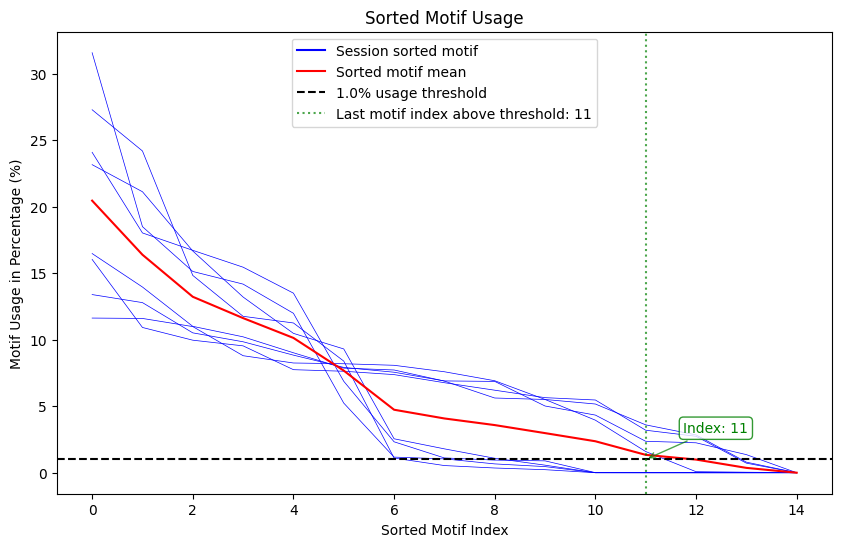

In [14]:
from vame.visualization import visualize_motif_thresholding

visualize_motif_thresholding(
    config=config_data,
    segmentation_algorithm="hmm",
    threshold=1.0,
)

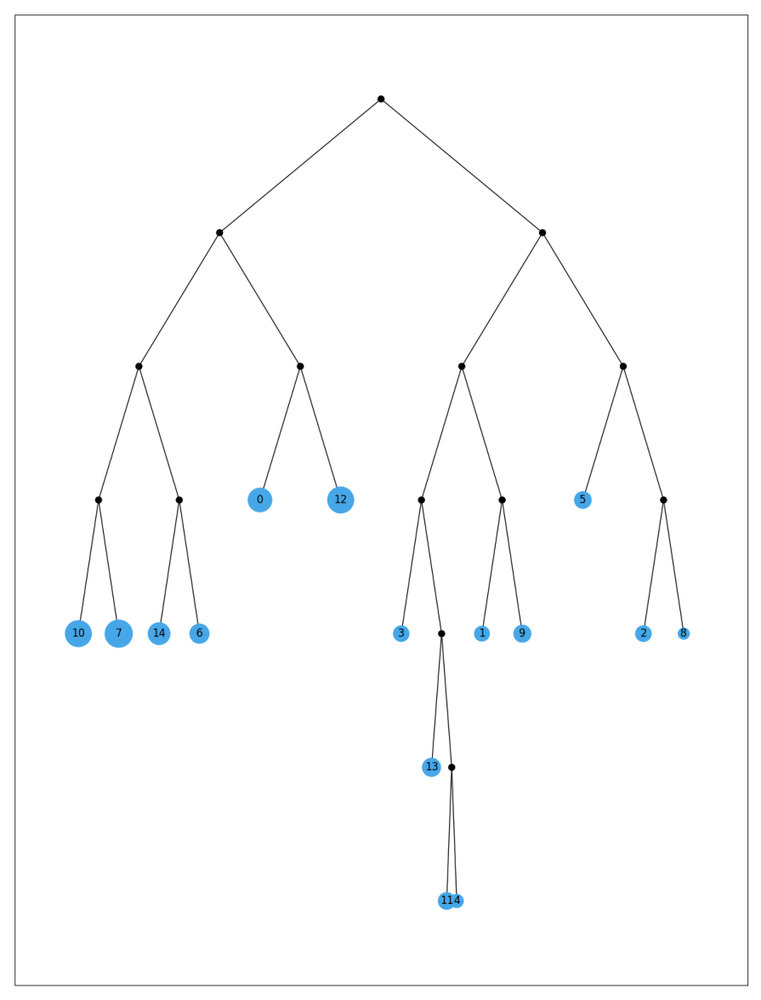

In [15]:
from vame.visualization import visualize_hierarchical_tree

visualize_hierarchical_tree(
    config=config_data,
    segmentation_algorithm="hmm",
)

In [16]:
from vame.visualization import visualize_umap

visualize_umap(
    config=config_data,
    show_figure="plotly",
)

2026-02-25 06:37:43.205 INFO  --- [MainThread] vame.visualization.umap : 682 : Computing UMAP embeddings for all sessions combined...
2026-02-25 06:37:43.274 INFO  --- [MainThread] vame.visualization.umap : 83 : Running UMAP calculation...
2026-02-25 06:37:43.277 | WARNING  | umap.umap_:_validate_parameters:1952 - /home/lukas/anaconda3/envs/VAME/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(

2026-02-25 06:38:49.788 INFO  --- [MainThread] vame.visualization.umap : 191 : UMAP embeddings saved to /mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/results/umap_embedding.nc
2026-02-25 06:38:49.898 INFO  --- [MainThread] vame.visualization.umap : 780 : UMAP figure saved to /mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/reports/umap/umap_VAME_hmm-15.png
2026-02-25 06:38:50.186 INFO  --- [MainThread] vame.visualizat

2026-02-25 06:38:55.657 INFO  --- [MainThread] vame.visualization.umap : 821 : Interactive UMAP figure saved to /mnt/windows-ssd/trophallaxis_detection_code/VAME_code/vame_konstanz_data_with_accel/reports/umap/umap_VAME_kmeans-15_interactive.html


In [17]:
vame.motif_videos(config=config_data)

2026-02-25 06:38:56.460 INFO  --- [MainThread] vame.analysis.videowriter : 213 : Creating motif videos for session hex_03_bee0_300--1377, algorithm: hmm, n_clusters: 15
2026-02-25 06:38:56.461 INFO  --- [MainThread] vame.analysis.videowriter : 67 : Motif videos getting created for hex_03_bee0_300--1377 ...
2026-02-25 06:38:56.509 INFO  --- [MainThread] vame.analysis.videowriter : 101 : Cluster: 0
2026-02-25 06:38:56.511 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 0%|          | 0/1000 [00:00<?, ?it/s]
2026-02-25 06:38:56.634 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 0%|          | 1/1000 [00:00<02:02,  8.13it/s]
2026-02-25 06:38:56.735 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 2%|2         | 20/1000 [00:00<00:09, 105.45it/s]
2026-02-25 06:38:56.840 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 4%|3         | 36/1000 [00:00<00:07, 126.57it/s]
2026-02-25 06:38:56.963 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 5%|5         | 5

In [18]:
vame.community_videos(config=config_data)

2026-02-25 10:29:53.195 INFO  --- [MainThread] vame.analysis.videowriter : 304 : Creating community videos for session hex_03_bee0_300--1377, algorithm: hmm, n_clusters: 15
2026-02-25 10:29:53.196 INFO  --- [MainThread] vame.analysis.videowriter : 75 : Community videos getting created for hex_03_bee0_300--1377 ...
2026-02-25 10:29:53.205 INFO  --- [MainThread] vame.analysis.videowriter : 101 : Cluster: 0
2026-02-25 10:29:53.206 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 0%|          | 0/1000 [00:00<?, ?it/s]
2026-02-25 10:29:53.309 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 1%|1         | 10/1000 [00:00<00:10, 97.98it/s]
2026-02-25 10:29:53.414 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 3%|3         | 33/1000 [00:00<00:05, 169.92it/s]
2026-02-25 10:29:53.573 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 5%|5         | 50/1000 [00:00<00:07, 134.43it/s]
2026-02-25 10:29:53.778 INFO  --- [MainThread] vame.analysis.videowriter : 83 : 6%|6   